In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pidly,os,emcee,corner
from astropy.io import fits
from astropy.wcs import WCS
from astropy.coordinates import SkyCoord
import astropy.units as u
from scipy.interpolate import RegularGridInterpolator
from astropy.stats import SigmaClip
from photutils.background import Background2D, MedianBackground
from my_script import limit_f,best_fitting
from scipy.constants import h,k,c
from scipy.optimize import curve_fit
from multiprocessing import Pool

In [2]:
idl=pidly.IDL('idl')
def loadfits(name):
    hdu=fits.open(name)
    idx=0
    while True:
        if hdu[idx].data is None:
            idx+=1
        else:
            break
    return hdu[idx]
def beam_flux(hdu,ra,dec,beam):
    w=WCS(hdu.header)
    c=SkyCoord(ra,dec,frame="icrs",unit=(u.hourangle, u.deg))
    data=hdu.data
    sigma_clip = SigmaClip(sigma=3.)
    bkg_estimator = MedianBackground()
    bkg = Background2D(data, (int(data.shape[0]/10),int(data.shape[1]/10)),sigma_clip=sigma_clip, bkg_estimator=bkg_estimator,exclude_percentile=50)
    data=data-np.mean(bkg.background)
    pixel=w.world_to_pixel(c)
    x,y=np.arange(data.shape[0]),np.arange(data.shape[1])
    f=RegularGridInterpolator((x,y),data,method='linear')
    if hdu.header['BUNIT']=='MJy/sr':
        ufactor=beam**2/37550.9
    elif hdu.header['BUNIT']=='Jy/pixel':
        ufactor=1.133*beam**2/abs(hdu.header['CDELT1']*hdu.header['CDELT2']*3600**2)
    elif hdu.header['BUNIT']=='mJy/arcsec**2':
        ufactor=1.133*beam**2/1000
    elif hdu.header['BUNIT']=='Jy/beam':
        ufactor=1
    try:
        flux=float(f(pixel[::-1]))*ufactor
    except ValueError:
        print("Coordinates of %s %s band doesn't match!"%(sourcename,tels[i]))
        return np.array([np.nan,np.nan])
    if np.isnan(flux):
        flpix=np.floor(pixel[::-1])
        flux=np.nanmean([data[tuple(flpix.astype(int)+np.array([0,0]))],data[tuple(flpix.astype(int)+np.array([1,0]))],\
                         data[tuple(flpix.astype(int)+np.array([0,1]))],data[tuple(flpix.astype(int)+np.array([1,1]))]])
    error=np.std(bkg.background)*ufactor
    return np.array([flux,error])
# ratio of convoloved flux from smaller beam image (PACS160) 
def beam_factor(name,orgbeam,targbeam):
    idx=np.where(basic_info[:,0]==name)[0][0]
    ra,dec=basic_info[idx,1],basic_info[idx,2]
    name=name.replace(' ','')
    for beam in [orgbeam,targbeam]:
        if os.path.exists('convolve/Images/%s_160_to_%3.1f.fits'%(name,beam)):
            continue
        kerfile='Kernel_HiRes_PACS_160_to_Gauss_%3.1f'%beam
        if not os.path.exists('convolve/Kernels/'+kerfile+'.fits'):
            parfile='/DATA/zj/CI_gasmass/dust_SED/photometry/make_kernel/Parameters/Parameters_file_PACS160_to_tmp.dat'
            f=open(parfile,'r',encoding='utf-8')
            flist=f.readlines()
            flist[17]="Gauss %3.1f\n"%beam
            flist[18]='Gauss_%3.1f           Filename of the PSF\n'%beam
            flist[23]='%3.1f                 Gaussian  FWHM\n'%beam
            f=open(parfile,'w',encoding='utf-8')
            f.writelines(flist)
            f.close()
            idl.filename='Parameters_file_PACS160_to_tmp'
            idl('.compile /DATA/zj/CI_gasmass/dust_SED/photometry/make_kernel/IDL_Routines/make_kernel_v21.pro')
            idl('make_kernel_v21,filename')
            os.system('cp /DATA/zj/CI_gasmass/dust_SED/photometry/make_kernel/Kernels/Ker_PACS160_to_tmp/Kernel_HiRes_PACS_160_to_Gauss_%3.1f.fits.gz convolve/Kernels/'%beam)
            os.system('gzip -d convolve/Kernels/*.gz')
        idl.kername=kerfile
        idl.imagename='%s_160'%name
        os.system('cp convolve/Herschel_raw/sorted/%s/%s_160.fits convolve/Images/'%(name,name))
        idl('.compile convolve/IDL_Routines/convolve_image.pro')
        idl('convolve_image,kername,imagename')
        os.system('mv convolve/Images/%s_160_convolved.fits convolve/Images/%s_160_to_%3.1f.fits'%(name,name,beam))
        os.system('rm convolve/Images/%s_160_kernel.fits'%name)
    
    hdu=loadfits('convolve/Images/%s_160_to_%3.1f.fits'%(name,orgbeam))
    orgflux=beam_flux(hdu,ra,dec,orgbeam)[0]
    hdu=loadfits('convolve/Images/%s_160_to_%3.1f.fits'%(name,targbeam))
    targflux=beam_flux(hdu,ra,dec,targbeam)[0]
    factor=targflux/orgflux
    return factor
#beam_factor('NGC1068',23,43.5)

In [3]:
basic_info=np.loadtxt('references/total_info_v2.csv',delimiter=',',dtype=str)
sourcename='NGC3227'
targbeam=43.5
tels=['MIPS_24','PACS_70','PACS_100','PACS_160','SPIRE_250','SPIRE_350','SPIRE_500']
tel_beams=[6.43,5.67,7.04,11.18,18.15,24.88,36.09]
for tel in tels:
    kerfile='Kernel_HiRes_%s_to_Gauss_%3.1f'%(tel,targbeam)
    if not os.path.exists('convolve/Kernels/%s.fits'%kerfile):
        parfile='/DATA/zj/CI_gasmass/dust_SED/photometry/make_kernel/Parameters/Parameters_file_Ker_to_target.dat'
        f=open(parfile,'r',encoding='utf-8')
        flist=f.readlines()
        flist[98]="Gauss %3.1f\n"%targbeam
        flist[99]='Gauss_%3.1f           Filename of the PSF\n'%targbeam
        flist[104]='%3.1f                 Gaussian  FWHM\n'%targbeam
        f=open(parfile,'w',encoding='utf-8')
        f.writelines(flist)
        f.close()
        idl.filename='Parameters_file_Ker_to_target'
        idl('.compile /DATA/zj/CI_gasmass/dust_SED/photometry/make_kernel/IDL_Routines/make_kernel_v21.pro')
        idl('make_kernel_v21,filename')
        os.system('cp /DATA/zj/CI_gasmass/dust_SED/photometry/make_kernel/Kernels/Ker_to_target/Kernel_HiRes_*_to_Gauss_%3.1f.fits.gz convolve/Kernels/'%targbeam)
        os.system('gzip -d convolve/Kernels/*fits.gz')
def convolve_image(name,tel,targbeam):
    idx=np.where(basic_info[:,0]==name)[0][0]
    name=name.replace(' ','')
    ra,dec=basic_info[idx,1],basic_info[idx,2]
    wl=tel.split('_')[-1]
    imname='convolve/Herschel_raw/sorted/%s/%s_%s.fits'%(name,name,wl)
    conname='convolve/Images/%s_%s_to_%3.1f.fits'%(name,wl,targbeam)
    if not os.path.exists(conname):
        if os.path.exists(imname):
            os.system('cp %s convolve/Images/'%imname)
            idl.kername='Kernel_HiRes_%s_to_Gauss_%3.1f'%(tel,targbeam)
            idl.imagename='%s_%s'%(name,wl)
            idl('.compile convolve/IDL_Routines/convolve_image.pro')
            idl('convolve_image,kername,imagename')
            os.system('mv convolve/Images/%s_%s_convolved.fits %s'%(name,wl,conname))
            os.system('rm convolve/Images/%s_%s_kernel.fits'%(name,wl))
    if os.path.exists(conname):
        hdu=loadfits(conname)
        flux=beam_flux(hdu,ra,dec,targbeam)
    else:
        flux=[np.nan,np.nan]
    return flux
#convolve_image(sourcename,'MIPS_24',targbeam)

In [4]:
sourcename='NGC3227'
targbeam=43.5
linedata=np.loadtxt('line_luminositeis/%s.csv'%sourcename,delimiter=',',dtype=str)
def read_mol(molname,linedata):
    idx=np.where(linedata[0]==molname)[0][0]
    nline=len(np.where(linedata[1:,idx+1]!='')[0])
    Jup=np.arange(nline)+1
    beams=linedata[Jup,idx+2].astype(float)
    factors=np.zeros_like(beams)
    for i in range(len(beams)):
        if beams[i]==targbeam or np.isnan(beams[i]):
            factors[i]=1
        else:
            factors[i]=beam_factor(sourcename,beams[i],targbeam)
    flux=linedata[Jup,idx:idx+2].astype(float)*np.array([factors]).T
    return np.concatenate([[Jup],flux.T]).T
CO_flux=read_mol('CO',linedata)
CI_flux=read_mol('CI',linedata)

dust_SED=np.zeros([len(tels),3])
dust_SED[:,0]=[tel.split('_')[-1] for tel in tels]
for i in range(len(tels)):
    dust_SED[i,1:3]=convolve_image(sourcename,tels[i],targbeam)
dust_SED

Coordinates of NGC3227 MIPS_24 band doesn't match!


array([[2.40000000e+01,            nan,            nan],
       [7.00000000e+01, 8.61040020e+00, 6.73218969e-03],
       [1.00000000e+02, 1.13874182e+01, 6.68760773e-02],
       [1.60000000e+02, 1.03110265e+01, 1.58608157e-01],
       [2.50000000e+02, 4.70894511e+00, 2.93527152e-03],
       [3.50000000e+02, 1.78109348e+00, 1.89906869e-03],
       [5.00000000e+02, 5.48484451e-01, 1.52795468e-03]])

array([1.31241635, 6.55640677, 2.46893628, 2.00454754, 5.16612194])

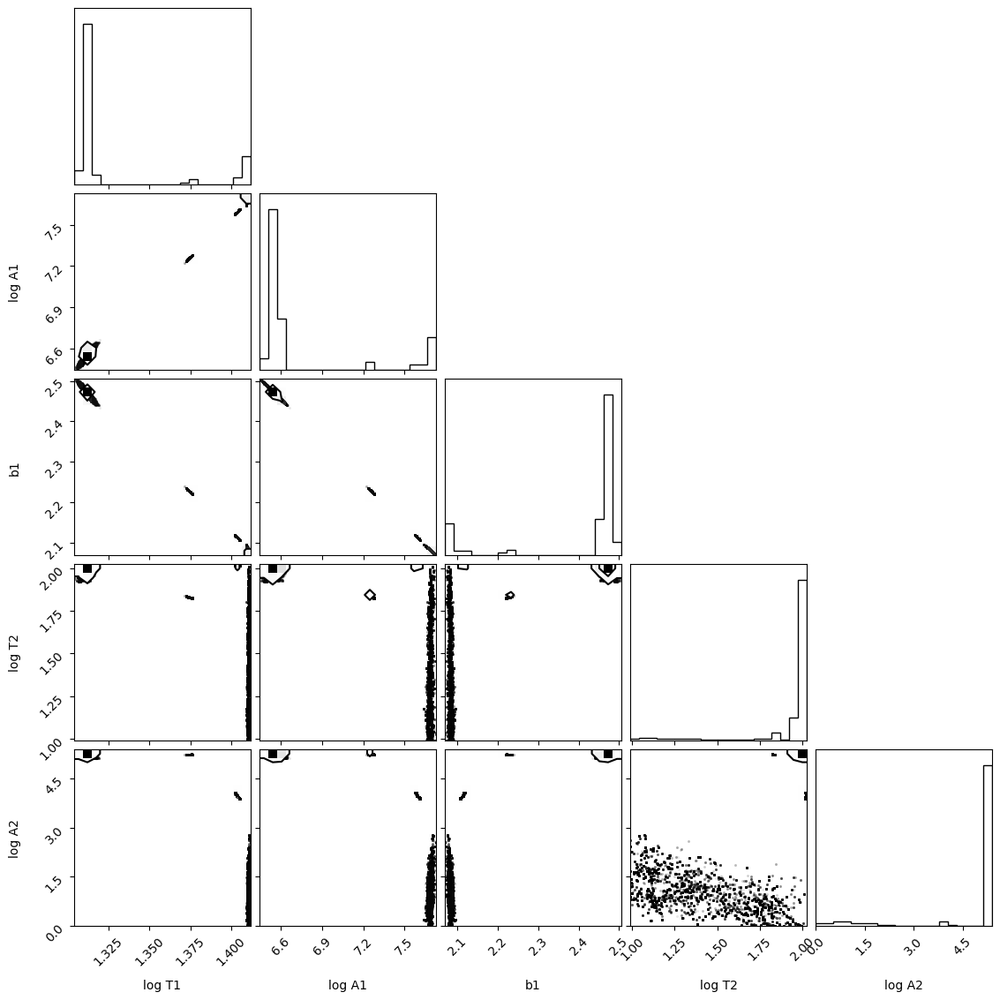

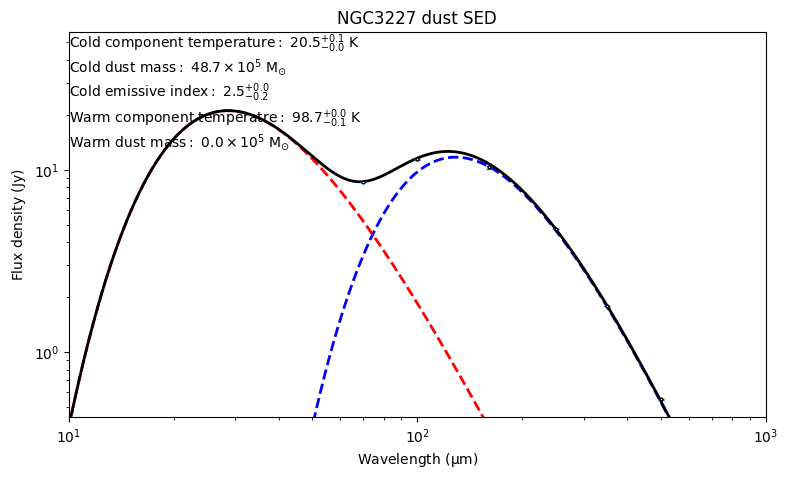

In [5]:
def modified_blackbody(wl,T,A,b):
    #the input wavelength is in unit of um      
    wl_m=wl*1e-6
    v=c/wl_m
    return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h*v / (k*10**T)) - 1)
def two_MBB_fit(sourcename,dust_sed,p0=np.array([1.4,8,2,2,5])):
    def log_prior(params):
        T1,A1,b1,T2,A2=params
        ll_T=limit_f(T1,0,2)+limit_f(T2,1,2)
        ll_A=limit_f(A1,0,10)+limit_f(A2,0,10)
        ll_b=limit_f(b1,0,5)
        return ll_T+ll_A+ll_b
    global log_likelyhood
    def log_likelyhood(params):
        T1,A1,b1,T2,A2=params
        if ((T1<0)*(T2<0)*(A1<0)*(A2<0)):return -np.inf
        ym=curve(xx,T1,A1,b1,T2,A2)
        ll=-0.5*np.sum(((ym-yy)/yerr)**2)
        return ll+log_prior(params)
    def curve(x,T1,A1,b1,T2,A2):
        return modified_blackbody(x,T1,A1,b1)+modified_blackbody(x,T2,A2,2)
    distance=read_distance(sourcename)
    dust_sed=dust_sed[~np.isnan(dust_sed).any(axis=1)]
    xx,yy,yerr=dust_sed[:,0],dust_sed[:,1],dust_sed[:,2]
    nwalkers=32
    try:
        popt,pcov=curve_fit(curve,xx,yy,p0=p0,sigma=yerr)
        p0=popt+np.random.randn(nwalkers,p0.shape[0])*popt*0.01
    except:
        p0=p0+np.random.randn(nwalkers,p0.shape[0])*0.1
    nwalkers, ndim = p0.shape
    samp_file='MCMC_samples/dust_SED/'+sourcename+'_samples.h5'
    if os.path.isfile(samp_file):
        sampler = emcee.backends.HDFBackend(samp_file, read_only=True)
    else:
        backend = emcee.backends.HDFBackend(samp_file)
        backend.reset(nwalkers,p0.shape[1])
        with Pool(8) as pool:
            sampler = emcee.EnsembleSampler(nwalkers, ndim, log_likelyhood, args=(),pool=pool,backend=backend)
            state=sampler.run_mcmc(p0,10000,progress=True)
    samples=sampler.get_chain(discard=4000)
    log_prob_samples = sampler.get_log_prob(discard=4000)
    max_index=np.where(log_prob_samples==np.max(log_prob_samples))
    max_params=samples[max_index[0][0],max_index[1][0]]
    sample_reshape=samples.reshape([samples.shape[0]*samples.shape[1],samples.shape[2]])
    rng = [(x.min(),x.max()) for x in sample_reshape.T]
    fig=corner.corner(sample_reshape,labels=['log T1','log A1','b1','log T2','log A2'],range=rng,bins=20)
    fig.savefig('plots/dust_SED/'+sourcename+'_corner.pdf')
    dm1=dust_mass(sample_reshape[:,1],distance,sample_reshape[:,2])
    dm2=dust_mass(sample_reshape[:,4],distance,2)
    T1,T2=10**sample_reshape[:,0],10**sample_reshape[:,3]
    result=best_fitting(sample_reshape)
    fig,ax=plt.subplots(1,1,figsize=(9,5))
    x0=np.logspace(1,3,1000)
    comp1=modified_blackbody(x0,max_params[0],max_params[1],max_params[2])
    comp2=modified_blackbody(x0,max_params[3],max_params[4],2)
    p1,=ax.plot(x0,comp1,'--b',lw=2)
    p2,=ax.plot(x0,comp2,'--r',lw=2)
    p3,=ax.plot(x0,comp1+comp2,'-k',lw=2)
    plt.errorbar(xx,yy,yerr=yerr,fmt='o',elinewidth=1,ms=2,mfc='w',mec='k',capthick=1,capsize=2)
    ax.set_xlim(10,1000)
    ax.set_ylim(min(yy)*0.8,max(yy)*5)
    plt.title(sourcename+' dust SED')
    str1=r'$\rm Cold~component~temperature :~ %3.1f_{%3.1f} ^{+%3.1f} \rm~K$'%(10**result[0,0],result[0,1],result[0,2])
    str2 = r'$ \rm Cold~dust~mass :~%3.1f \times 10^5~M_{\odot}$' % (dust_mass(result[1,0],distance,result[2,0])/1e5)
    str3 = r'$\rm Cold~emissive~index:~ %3.1f _{%3.1f} ^{+%3.1f}$' % (result[2, 0], result[2, 1], result[2, 2])
    str4 = r'$\rm Warm~component~temperatre:~ %3.1f _{%3.1f} ^{+%3.1f} \rm ~K$' % (10**result[3, 0], result[3, 1], result[3, 2])
    str5 = r'$ \rm Warm~dust~mass :~%3.1f \times 10^5~M_{\odot}$' % (dust_mass(result[4, 0],distance,2)/1e5)
    plt.text(0,1,str1+'\n'+str2+'\n'+str3+'\n'+str4+'\n'+str5,ha='left',va='top',transform=ax.transAxes,fontsize=10)
    plt.xscale('log')
    plt.yscale('log')
    ax.set_xlabel(r"$\rm Wavelength ~ (\mu m)$")
    ax.set_ylabel(r"$\rm Flux ~density ~ \rm (Jy)$")
    plt.savefig('plots/dust_SED/'+sourcename+'_SED.pdf')
    return max_params
def read_distance(sourcename):
    idx=np.where(basic_info[:,0]==sourcename)[0][0]
    d,r=float(basic_info[idx,4]),float(basic_info[idx,3])
    if not np.isnan(d):
        distance=d
    else:
        distance=r*c/1e3/67.8*(1+r)
    return distance
def dust_mass(A,distance,beta):
    M_dust=10**A*(distance*3.0857*10**24)**2/3.98/(250*10**(-6))**beta/1.9891e33*1e-26
    return M_dust
def single_MBB_fit(sourcename,dust_sed,p0=np.array([1.4,8,2])):
    def log_prior(params):
        T1,A1,b1=params
        ll_T=limit_f(T1,0,3)
        ll_A=limit_f(A1,0,10)
        ll_b=limit_f(b1,0,5)
        return ll_T+ll_A+ll_b
    global log_likelyhood
    def log_likelyhood(params):
        T1,A1,b1=params
        if ((T1<0)*(A1<0)): return -np.inf
        ym=curve(xx,T1,A1,b1)
        ll=-0.5*np.sum(((ym-yy)/yerr)**2)
        return ll+log_prior(params)
    def curve(x,T1,A1,b1):
        return modified_blackbody(x,T1,A1,b1)
    distance=read_distance(sourcename)
    dust_sed=dust_sed[~np.isnan(dust_sed).any(axis=1)]
    xx,yy,yerr=dust_sed[:,0],dust_sed[:,1],dust_sed[:,2]
    nwalkers=32
    try:
        popt,pcov=curve_fit(curve,xx,yy,p0=p0,sigma=yerr)
        p0=popt+np.random.randn(nwalkers,p0.shape[0])*popt*0.01
    except:
        p0=p0+np.random.randn(nwalkers,p0.shape[0])*0.1
    nwalkers, ndim = p0.shape
    samp_file='MCMC_samples/dust_SED/'+sourcename+'_samples.h5'
    if os.path.isfile(samp_file):
        sampler = emcee.backends.HDFBackend(samp_file, read_only=True)
    else:
        backend = emcee.backends.HDFBackend(samp_file)
        backend.reset(nwalkers,p0.shape[1])
        with Pool(8) as pool:
            sampler = emcee.EnsembleSampler(nwalkers, ndim, log_likelyhood, args=(),pool=pool,backend=backend)
            state=sampler.run_mcmc(p0,10000,progress=True)
    samples=sampler.get_chain(discard=4000)
    log_prob_samples = sampler.get_log_prob(discard=4000)
    max_index=np.where(log_prob_samples==np.max(log_prob_samples))
    max_params=samples[max_index[0][0],max_index[1][0]]
    sample_reshape=samples.reshape([samples.shape[0]*samples.shape[1],samples.shape[2]])
    rng = [(x.min(),x.max()) for x in sample_reshape.T]
    fig=corner.corner(sample_reshape,labels=['log T1','log A1','b1'],range=rng,bins=20)
    fig.savefig('plots/dust_SED/'+sourcename+'_corner.pdf')
    dm1=dust_mass(sample_reshape[:,1],distance,sample_reshape[:,2])
    T1=10**sample_reshape[:,0]
    result=best_fitting(sample_reshape)
    fig,ax=plt.subplots(1,1,figsize=(9,5))
    x0=np.logspace(1,3,1000)
    comp1=modified_blackbody(x0,max_params[0],max_params[1],max_params[2])
    p1,=ax.plot(x0,comp1,'-k',lw=2)
    plt.errorbar(xx,yy,yerr=yerr,fmt='o',elinewidth=1,ms=2,mfc='w',mec='k',capthick=1,capsize=2)
    ax.set_xlim(10,1000)
    ax.set_ylim(min(yy)*0.8,max(yy)*5)
    plt.title(sourcename+' dust SED')
    str1=r'$\rm Cold~component~temperature :~ %3.1f_{%3.1f} ^{+%3.1f} \rm~K$'%(10**result[0,0],result[0,1],result[0,2])
    str2 = r'$ \rm Cold~dust~mass :~%3.1f \times 10^5~M_{\odot}$' % (dust_mass(result[1,0],distance,result[2,0])/1e5)
    str3 = r'$\rm Cold~emissive~index:~ %3.1f _{%3.1f} ^{+%3.1f}$' % (result[2, 0], result[2, 1], result[2, 2])
    plt.text(0,1,str1+'\n'+str2+'\n'+str3,ha='left',va='top',transform=ax.transAxes,fontsize=10)
    plt.xscale('log')
    plt.yscale('log')
    ax.set_xlabel(r"$\rm Wavelength ~ (\mu m)$")
    ax.set_ylabel(r"$\rm Flux ~density ~ \rm (Jy)$")
    plt.savefig('plots/dust_SED/'+sourcename+'_SED.pdf')
    return max_params
def draw_SED(xx,yy,yerr,result,max_params):
    fig,ax=plt.subplots(1,1,figsize=(9,5))
    x0=np.logspace(1,3,1000)
    comp1=modified_blackbody(x0,max_params[0],max_params[1],max_params[2])
    comp2=modified_blackbody(x0,max_params[3],max_params[4],2)
    p1,=ax.plot(x0,comp1,'--b',lw=2)
    p2,=ax.plot(x0,comp2,'--r',lw=2)
    p3,=ax.plot(x0,comp1+comp2,'-k',lw=2)
    plt.errorbar(xx,yy,yerr=yerr,fmt='o',elinewidth=1,ms=2,mfc='w',mec='k',capthick=1,capsize=2)
    ax.legend([p1,p2,p3],['Cold dust emission','Warm dust emission','Total'],loc='upper right')
    ax.set_xlim(10,1000)
    ax.set_ylim(min(yy)*0.8,max(yy)*5)
    plt.title(source_name+' dust SED')
    str1=r'$\rm Cold~component~temperature :~ %3.1f_{%3.1f} ^{+%3.1f} \rm~K$'%(10**result[0,0],result[0,1],result[0,2])
    str2 = r'$ \rm Cold~dust~mass :~%3.1f \times 10^5~M_{\odot}$' % (dust_mass(result[1,0],distance,result[2,0])/1e5)
    str3 = r'$\rm Cold~emissive~index:~ %3.1f _{%3.1f} ^{+%3.1f}$' % (result[2, 0], result[2, 1], result[2, 2])
    str4 = r'$\rm Warm~component~temperatre:~ %3.1f _{%3.1f} ^{+%3.1f} \rm ~K$' % (10**result[3, 0], result[3, 1], result[3, 2])
    str5 = r'$ \rm Warm~dust~mass :~%3.1f \times 10^5~M_{\odot}$' % (dust_mass(result[4, 0],distance,2)/1e5)
    plt.text(0,1,str1+'\n'+str2+'\n'+str3+'\n'+str4+'\n'+str5,ha='left',va='top',transform=ax.transAxes,fontsize=10)
    plt.xscale('log')
    plt.yscale('log')
    ax.set_xlabel(r"$\rm Wavelength ~ (\mu m)$")
    ax.set_ylabel(r"$\rm Flux ~density ~ \rm (Jy)$")
two_MBB_fit(sourcename,dust_SED)

In [7]:
def write_flux(SED,mol_name,file_path):
    if not os.path.exists(file_path):
        tmp=np.concatenate([[[mol_name,'flux','error']],SED])
        np.savetxt(file_path,tmp,fmt='%s',delimiter=',')
    else:
        ori=np.loadtxt(file_path,delimiter=',',dtype=str)
        if mol_name not in ori[0]:
            tmp=np.concatenate([[[mol_name,'flux','error']],SED])
            a1,a2,b1,b2=ori.shape[0],ori.shape[1],tmp.shape[0],tmp.shape[1]
            result=np.empty([max(a1,b1),a2+b2],dtype='U64')
            result[:a1,:a2]=ori
            result[:b1,a2:a2+b2]=tmp
            np.savetxt(file_path,result,fmt='%s',delimiter=',')

106


/tmp/ipykernel_241284/197243626.py:53: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(1,1,figsize=(9,5))
/tmp/ipykernel_241284/197243626.py:5: RuntimeWarning: overflow encountered in exp
  return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h*v / (k*10**T)) - 1)
/tmp/ipykernel_241284/1654063520.py:37: RuntimeWarning: Mean of empty slice
  flux=np.nanmean([data[tuple(flpix.astype(int)+np.array([0,0]))],data[tuple(flpix.astype(int)+np.array([1,0]))],\
/tmp/ipykernel_241284/197243626.py:5: RuntimeWarning: divide by zero encountered in divide
  return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h*v / (k*10**T)) - 1)
/home/zj/.local/lib/python3.8/site-packages/scipy/optimize/_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be est

Coordinates of NGC3227 MIPS_24 band doesn't match!


/tmp/ipykernel_241284/197243626.py:5: RuntimeWarning: overflow encountered in exp
  return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h*v / (k*10**T)) - 1)
/tmp/ipykernel_241284/197243626.py:5: RuntimeWarning: overflow encountered in exp
  return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h*v / (k*10**T)) - 1)
/home/zj/.local/lib/python3.8/site-packages/scipy/optimize/_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_241284/197243626.py:5: RuntimeWarning: divide by zero encountered in divide
  return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h*v / (k*10**T)) - 1)
/tmp/ipykernel_241284/197243626.py:5: RuntimeWarning: divide by zero encountered in divide
  return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h*v / (k*10**T)) - 1)
/tmp/ipykernel_241284/197243626.py:5: RuntimeWarning: divide by zero encountered in divide
  return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h

Coordinates of NGC5135 MIPS_24 band doesn't match!


/tmp/ipykernel_241284/1654063520.py:37: RuntimeWarning: Mean of empty slice
  flux=np.nanmean([data[tuple(flpix.astype(int)+np.array([0,0]))],data[tuple(flpix.astype(int)+np.array([1,0]))],\
/tmp/ipykernel_241284/1654063520.py:37: RuntimeWarning: Mean of empty slice
  flux=np.nanmean([data[tuple(flpix.astype(int)+np.array([0,0]))],data[tuple(flpix.astype(int)+np.array([1,0]))],\
/tmp/ipykernel_241284/197243626.py:5: RuntimeWarning: divide by zero encountered in divide
  return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h*v / (k*10**T)) - 1)
/tmp/ipykernel_241284/197243626.py:5: RuntimeWarning: divide by zero encountered in divide
  return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h*v / (k*10**T)) - 1)
/tmp/ipykernel_241284/1654063520.py:37: RuntimeWarning: Mean of empty slice
  flux=np.nanmean([data[tuple(flpix.astype(int)+np.array([0,0]))],data[tuple(flpix.astype(int)+np.array([1,0]))],\
/tmp/ipykernel_241284/1654063520.py:37: RuntimeWarning: Mean of empty slice
  flux=np.nanmean([data

Coordinates of NGC7130 MIPS_24 band doesn't match!


/tmp/ipykernel_241284/197243626.py:5: RuntimeWarning: divide by zero encountered in divide
  return 10**A*wl_m**(-b)*2*h*v**3/ c**2 / (np.exp(h*v / (k*10**T)) - 1)


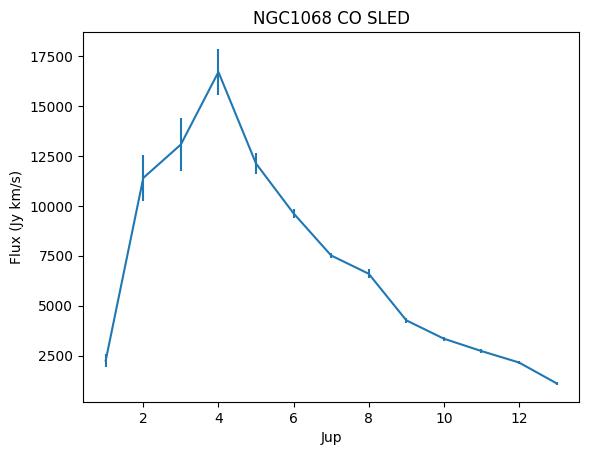

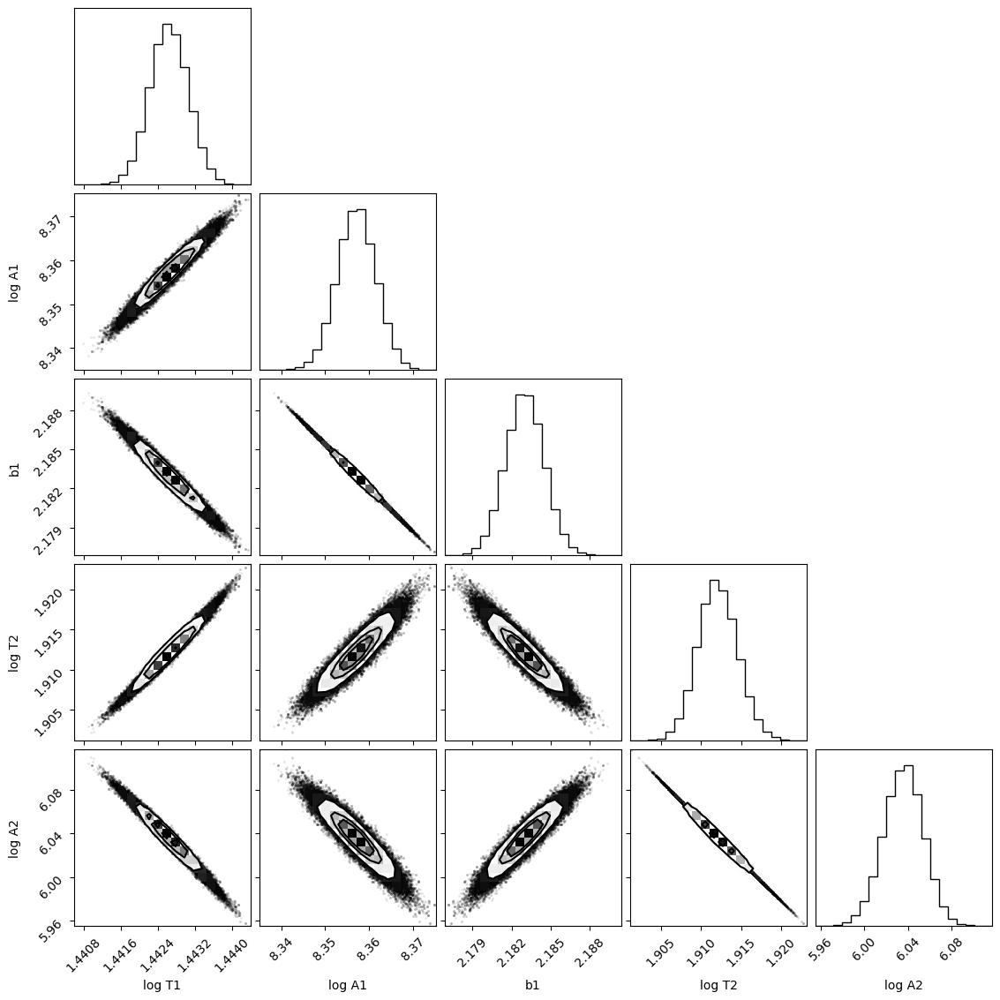

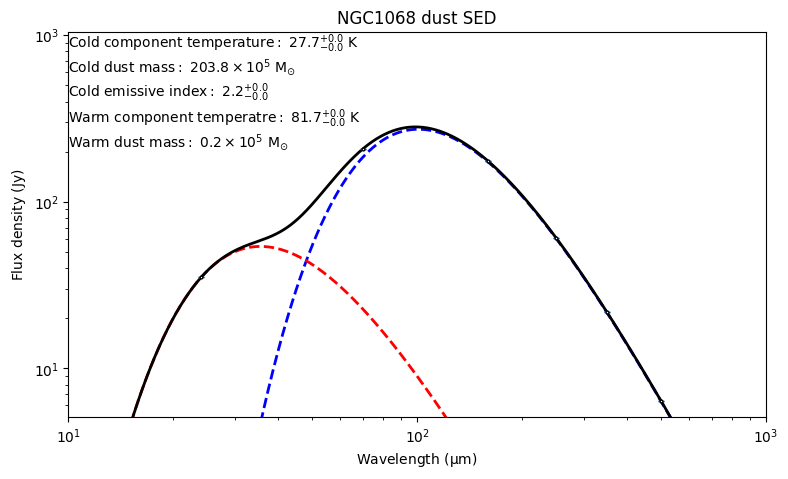

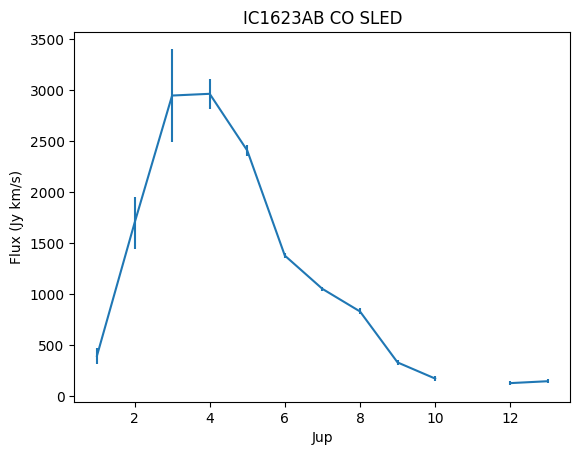

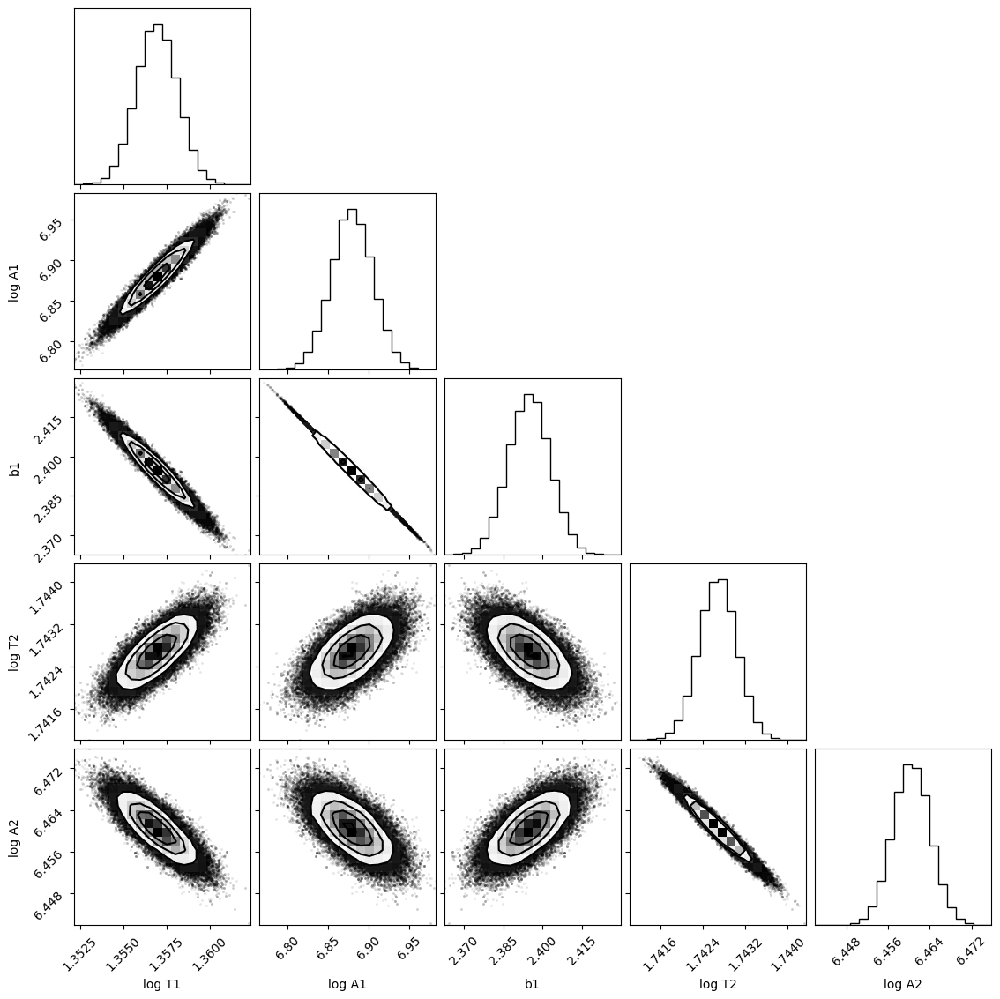

...

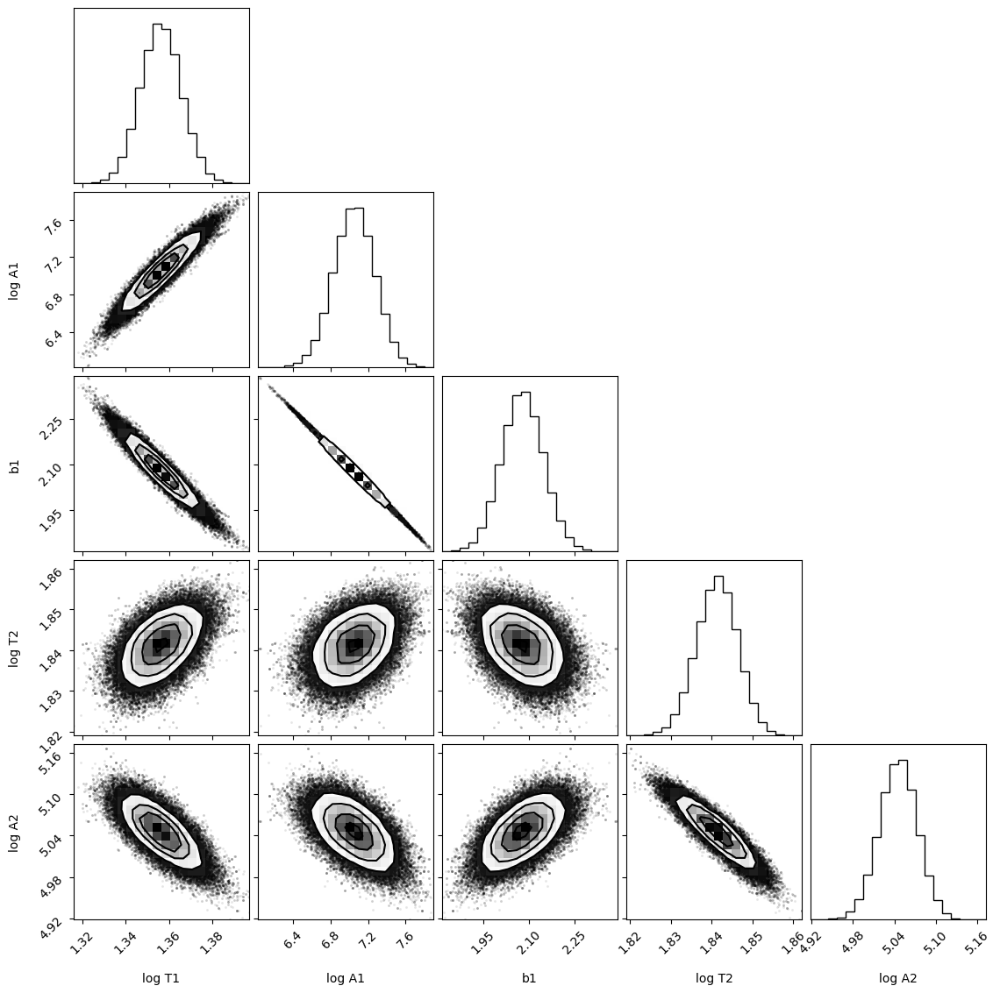

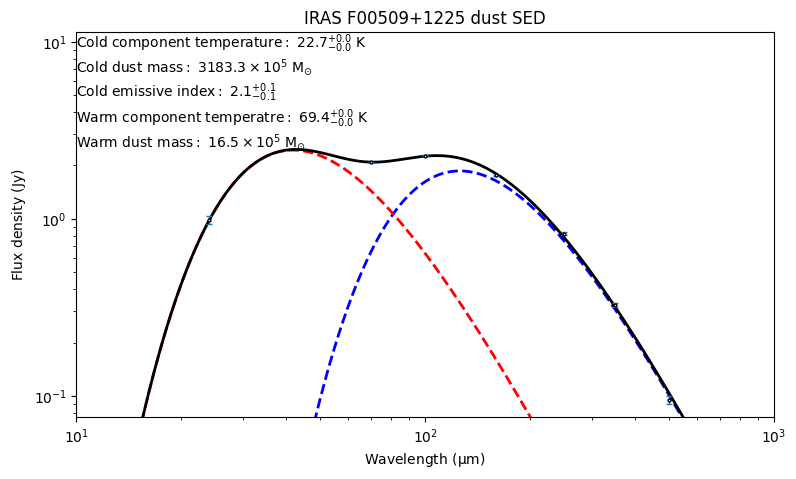

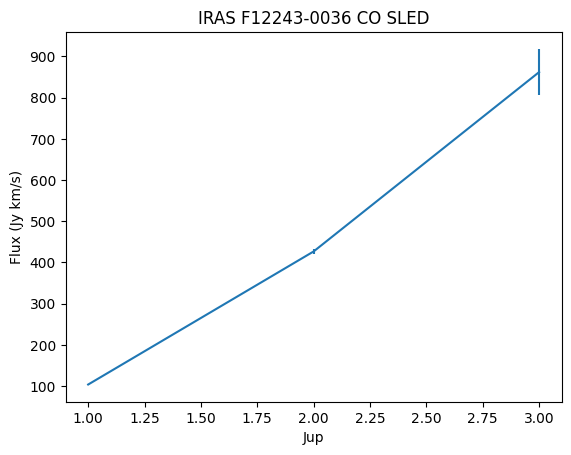

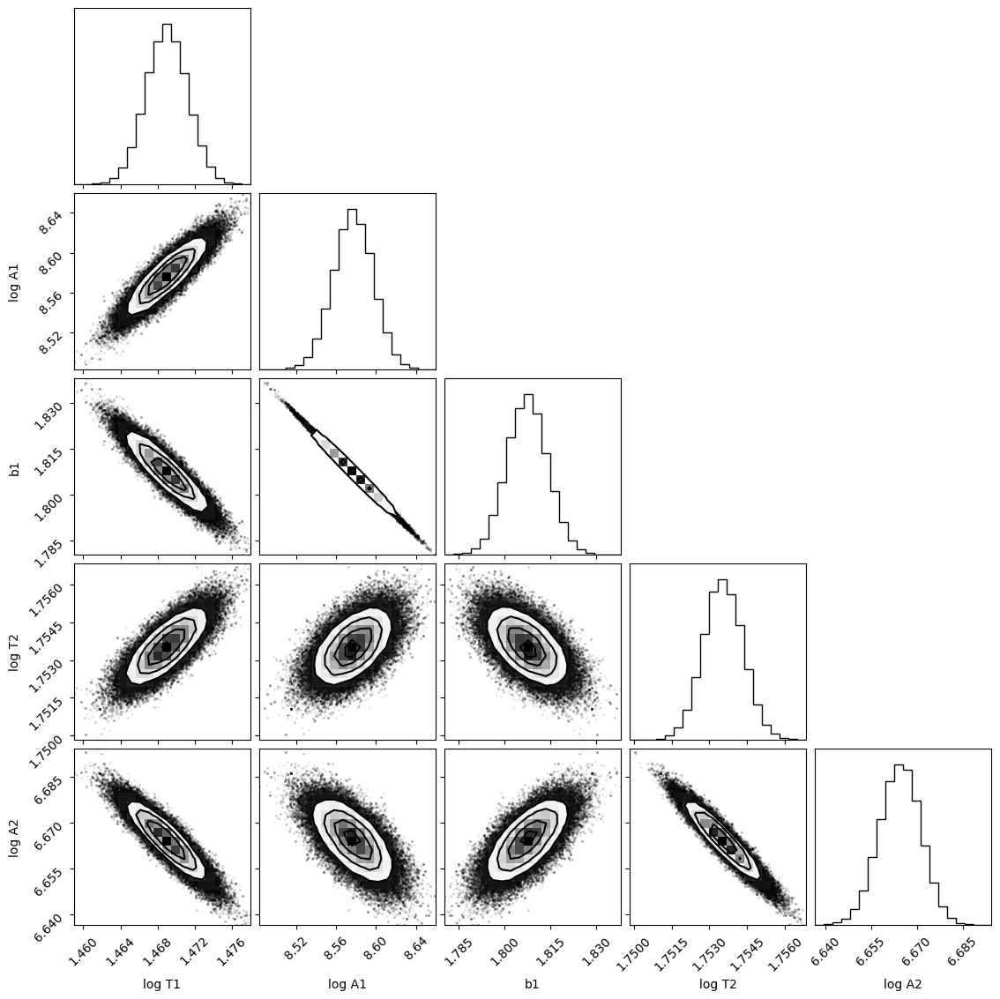

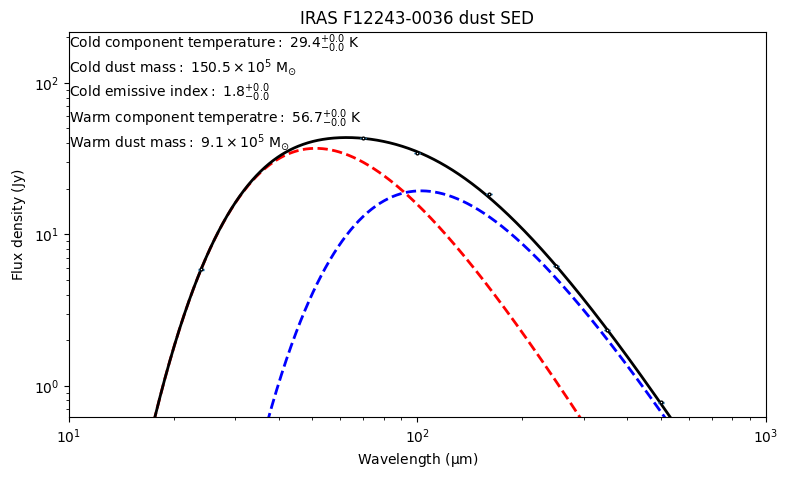

In [8]:
print(len(basic_info))
for sourcename in basic_info[1:,0]:
    if not os.path.exists('line_luminositeis/%s.csv'%sourcename):
        continue
    linedata=np.loadtxt('line_luminositeis/%s.csv'%sourcename,delimiter=',',dtype=str)
    CO_flux=read_mol('CO',linedata)
    CI_flux=read_mol('CI',linedata)
    
    dust_SED=np.zeros([len(tels),3])
    dust_SED[:,0]=[tel.split('_')[-1] for tel in tels]
    for i in range(len(tels)):
        dust_SED[i,1:3]=convolve_image(sourcename,tels[i],targbeam)
        
    write_flux(CO_flux,'CO Jup','beam_matched_flux/%s.csv'%sourcename.replace(' ',''))
    write_flux(CI_flux,'CI Jup','beam_matched_flux/%s.csv'%sourcename.replace(' ',''))
    write_flux(dust_SED,'dust wavelength','beam_matched_flux/%s.csv'%sourcename.replace(' ',''))
    plt.figure()
    plt.title(sourcename+' CO SLED')
    plt.errorbar(CO_flux[:,0],CO_flux[:,1],yerr=CO_flux[:,2])
    #plt.plot(dust_SED)
    plt.ylabel('Flux (Jy km/s)')
    plt.xlabel('Jup')
    plt.savefig('plots/CO_SLED/%s_CO_SLED.pdf'%(sourcename))
    
    two_MBB_fit(sourcename,dust_SED)